# Spatial Disparity Studio: Statistical Testing

In [141]:
import geopandas as gpd

## Composition

In [142]:
sd = gpd.read_file('sdtracts.geojson', driver='GeoJSON')

In [143]:
import seaborn as sns

In [144]:
sd = sd.fillna(value=0)

In [145]:
vars = [ 'n_total_pop', 'n_nonhisp_white_persons',
       'n_nonhisp_black_persons', 'n_hispanic_persons']
short = sd[vars]

In [146]:
short.head()

,n_total_pop,n_nonhisp_white_persons,n_nonhisp_black_persons,n_hispanic_persons
0,3093.0,2389.0,0.0,489.0
1,1891.0,1569.0,10.0,140.0
2,4542.0,3390.0,4.0,616.0
3,5239.0,3820.0,266.0,871.0
4,3801.0,2148.0,228.0,884.0


In [147]:
(short.n_total_pop==0).sum()

2

In [148]:
den = short.n_total_pop
den = den + (1 * den==0)

In [149]:
short['p_white'] = short.n_nonhisp_white_persons / den
short['p_black'] = short.n_hispanic_persons / den
short['p_hispanic'] = short.n_hispanic_persons / den

/tmp/ipykernel_3461790/813278778.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  short['p_white'] = short.n_nonhisp_white_persons / den
/tmp/ipykernel_3461790/813278778.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  short['p_black'] = short.n_hispanic_persons / den
/tmp/ipykernel_3461790/813278778.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pan

In [150]:
short.head()

,n_total_pop,n_nonhisp_white_persons,n_nonhisp_black_persons,n_hispanic_persons,p_white,p_black,p_hispanic
0,3093.0,2389.0,0.0,489.0,0.772389,0.158099,0.158099
1,1891.0,1569.0,10.0,140.0,0.829720,0.074035,0.074035
2,4542.0,3390.0,4.0,616.0,0.746367,0.135623,0.135623
3,5239.0,3820.0,266.0,871.0,0.729147,0.166253,0.166253
4,3801.0,2148.0,228.0,884.0,0.565114,0.232570,0.232570


In [151]:
h = short.sort_values(by='p_hispanic')

h.head()

,n_total_pop,n_nonhisp_white_persons,n_nonhisp_black_persons,n_hispanic_persons,p_white,p_black,p_hispanic
627,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
238,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
414,2957.0,2347.0,88.0,122.0,0.793710,0.041258,0.041258
460,3250.0,2809.0,28.0,145.0,0.864308,0.044615,0.044615
467,5584.0,4763.0,11.0,264.0,0.852973,0.047278,0.047278


In [152]:
h.shape

(628, 7)

In [153]:
h['wcdf'] = h.n_nonhisp_white_persons.cumsum() / h.n_nonhisp_white_persons.sum()
h['hcdf'] = h.n_hispanic_persons.cumsum() / h.n_hispanic_persons.sum()
h['tcdf'] = h.n_total_pop.cumsum() / h.n_total_pop.sum()
h['bcdf'] = h.n_nonhisp_black_persons.cumsum() / h.n_nonhisp_black_persons.sum()
h.head()

,n_total_pop,n_nonhisp_white_persons,n_nonhisp_black_persons,n_hispanic_persons,p_white,p_black,p_hispanic,wcdf,hcdf,tcdf,bcdf
627,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
238,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
414,2957.0,2347.0,88.0,122.0,0.793710,0.041258,0.041258,0.001554,0.000109,0.000892,0.000564
460,3250.0,2809.0,28.0,145.0,0.864308,0.044615,0.044615,0.003413,0.000239,0.001872,0.000743
467,5584.0,4763.0,11.0,264.0,0.852973,0.047278,0.047278,0.006566,0.000475,0.003556,0.000814


In [154]:
import seaborn as sns

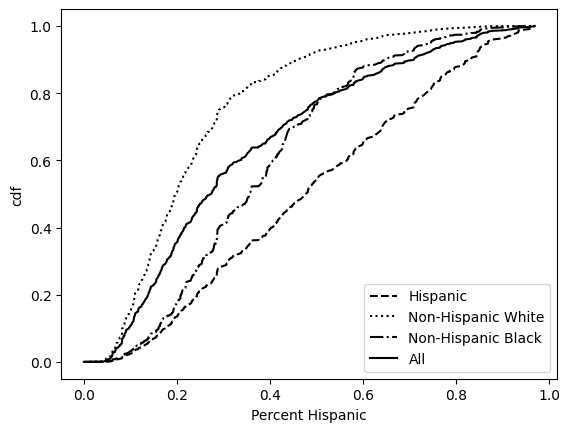

In [155]:
import matplotlib.pyplot as plt 
  

  
# plot lines 
plt.plot(h.p_hispanic, h.hcdf, label = "Hispanic", linestyle='dashed', color='k') 
plt.plot(h.p_hispanic, h.wcdf, label = "Non-Hispanic White", linestyle='dotted', color='k') 
plt.plot(h.p_hispanic, h.bcdf, label = "Non-Hispanic Black", linestyle='dashdot', color='k') 

plt.plot(h.p_hispanic, h.tcdf, label='All', color='k')
plt.xlabel('Percent Hispanic')
plt.ylabel('cdf')
plt.legend() 
plt.show()

In [156]:
h[h.hcdf>=0.5].iloc[0]

n_total_pop                31118.000000
n_nonhisp_white_persons     4191.000000
n_nonhisp_black_persons      970.000000
n_hispanic_persons         14901.000000
p_white                        0.134681
p_black                        0.478855
p_hispanic                     0.478855
wcdf                           0.908881
hcdf                           0.503078
tcdf                           0.749890
bcdf                           0.721848
Name: 307, dtype: float64

In [157]:
phh50 = h[h.hcdf>=0.5].iloc[0].p_hispanic

In [158]:
phh50

0.4788546821775178

In [159]:
phw50 = h[h.wcdf>=0.5].iloc[0].p_hispanic

In [160]:
phw50

0.1966406023747466

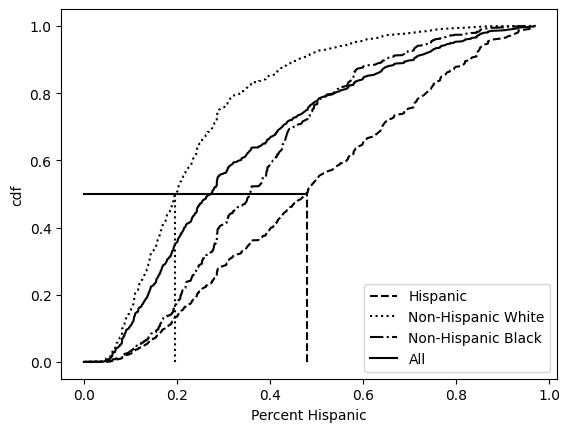

In [161]:
import matplotlib.pyplot as plt 
  


# plot lines 
plt.plot(h.p_hispanic, h.hcdf, label = "Hispanic", linestyle='dashed', color='k') 
plt.plot(h.p_hispanic, h.wcdf, label = "Non-Hispanic White", linestyle='dotted', color='k') 
plt.plot(h.p_hispanic, h.bcdf, label = "Non-Hispanic Black", linestyle='dashdot', color='k') 

plt.plot(h.p_hispanic, h.tcdf, label='All', color='k')
plt.xlabel('Percent Hispanic')
plt.ylabel('cdf')
plt.legend() 
plt.plot([0, phh50], [.5, .5], linestyle='solid', color='k')
plt.plot([phh50, phh50], [0, .5], linestyle='dashed', color='k')
plt.plot([phw50, phw50], [0, .5], linestyle='dotted', color='k')
plt.show()

In [162]:
h = short.sort_values(by='p_white')

h.head()

,n_total_pop,n_nonhisp_white_persons,n_nonhisp_black_persons,n_hispanic_persons,p_white,p_black,p_hispanic
627,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
238,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
246,5199.0,40.0,22.0,5037.0,0.007694,0.968840,0.968840
243,6978.0,118.0,154.0,6517.0,0.016910,0.933935,0.933935
565,4825.0,93.0,20.0,4614.0,0.019275,0.956269,0.956269


In [163]:
h['wcdf'] = h.n_nonhisp_white_persons.cumsum() / h.n_nonhisp_white_persons.sum()
h['hcdf'] = h.n_hispanic_persons.cumsum() / h.n_hispanic_persons.sum()
h['tcdf'] = h.n_total_pop.cumsum() / h.n_total_pop.sum()
h['bcdf'] = h.n_nonhisp_black_persons.cumsum() / h.n_nonhisp_black_persons.sum()
h.head()

,n_total_pop,n_nonhisp_white_persons,n_nonhisp_black_persons,n_hispanic_persons,p_white,p_black,p_hispanic,wcdf,hcdf,tcdf,bcdf
627,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
238,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
246,5199.0,40.0,22.0,5037.0,0.007694,0.968840,0.968840,0.000026,0.004507,0.001568,0.000141
243,6978.0,118.0,154.0,6517.0,0.016910,0.933935,0.933935,0.000105,0.010339,0.003672,0.001128
565,4825.0,93.0,20.0,4614.0,0.019275,0.956269,0.956269,0.000166,0.014468,0.005127,0.001256


In [164]:
phw50 = h[h.hcdf>=0.5].iloc[0].p_white
pww50 = h[h.wcdf>=0.5].iloc[0].p_white

In [165]:
phw50, pww50

(0.27341929470250115, 0.6068664417543164)

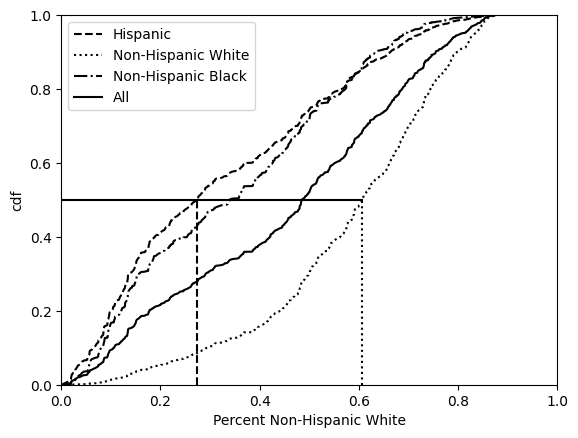

In [166]:
import matplotlib.pyplot as plt 
  
# create data 

  
# plot lines 
plt.plot(h.p_white, h.hcdf, label = "Hispanic", linestyle='dashed', color='k') 
plt.plot(h.p_white, h.wcdf, label = "Non-Hispanic White", linestyle='dotted', color='k') 
plt.plot(h.p_white, h.bcdf, label = "Non-Hispanic Black", linestyle='dashdot', color='k') 

plt.plot(h.p_white, h.tcdf, label='All', color='k')
plt.xlabel('Percent Non-Hispanic White')
plt.ylabel('cdf')
plt.ylim(0, 1)
plt.xlim(0, 1)
plt.plot([phw50, phw50], [0, .5], linestyle='dashed', color='k')
plt.plot([pww50, pww50], [0, .5], linestyle='dotted', color='k')
plt.plot([0, pww50], [.5, .5], linestyle='solid', color='k')


plt.legend() 
plt.show()

## Difference in Population Proportions

### Research Question
Is there a significant difference between the Hispanic composition of the tract populations between tracts that intersect and do not intersect the highway buffer?

**Parameters of Interest**: $p1 - p2$ where $p1$ is the percentage Hispanic for tracts that do not intersect the buffer, $p2$ the percentage Hispanic for tracts to do intersect the buffer.

**Null Hypothesis**: $p1-p2=0$

**Alternative Hypothesis**: $p1-p2<0$


In [167]:
estimates = gpd.read_file('estimate.geojson', driver='GeoJSON')

In [168]:
estimates.head()

,n_total_pop,n_nonhisp_white_persons,n_nonhisp_black_persons,n_hispanic_persons,income,median_household_income,per_capita_income,pci,geometry
0,7.562176e+05,3.215112e+05,35412.835692,292432.788563,2.759467e+10,77579.151075,37818.115972,36490.385567,"MULTIPOLYGON (((475814.243 3628586.622, 475809..."
1,2.559855e+06,1.189245e+06,120671.164353,825084.214846,9.865887e+10,66429.266067,32423.814728,38540.797907,"MULTIPOLYGON (((480756.394 3599073.688, 480752..."


In [169]:
estimates['p_hispanic_persons'] = estimates.n_hispanic_persons / estimates.n_total_pop

In [170]:
estimates.p_hispanic_persons

0    0.386705
1    0.322317
Name: p_hispanic_persons, dtype: float64

Thus $\hat{p1} = 32.32$% and $\hat{p2}=38.67$%. The percentage Hispanic is higher in the buffer than outside the buffer.

In [171]:
import statsmodels.api as sm
import numpy as np
# https://tirthajyoti.github.io/Intro_Hypothesis_Testing.html

In [172]:
count2 = estimates.n_hispanic_persons[0] # inside
nobs2 = estimates.n_total_pop[0]
count1 = estimates.n_hispanic_persons[1]
nobs1 = estimates.n_total_pop[1]

np.random.seed(12345)
size=1000
pop1 = np.random.binomial(1, count1/nobs1, size)
pop2 = np.random.binomial(1, count2/nobs2, size)

In [173]:
sm.stats.ttest_ind(pop1, pop2) # pct hispanic outside buffer versus inside buffer

(-2.797459637563787, 0.005199988209663126, 1998.0)

The function returns three values: (a) the test statistic, (b) the p-value, (c) the degrees of freedom used in the test.

In [174]:
sm.stats.ttest_ind?

Signature:
sm.stats.ttest_ind(
    x1,
    x2,
    alternative='two-sided',
    usevar='pooled',
    weights=(None, None),
    value=0,
)
Docstring:
ttest independent sample

Convenience function that uses the classes and throws away the intermediate
results,
compared to scipy stats: drops axis option, adds alternative, usevar, and
weights option.

Parameters
----------
x1 : array_like, 1-D or 2-D
    first of the two independent samples, see notes for 2-D case
x2 : array_like, 1-D or 2-D
    second of the two independent samples, see notes for 2-D case
alternative : str
    The alternative hypothesis, H1, has to be one of the following

       * 'two-sided' (default): H1: difference in means not equal to value
       * 'larger' :   H1: difference in means larger than value
       * 'smaller' :  H1: difference in means smaller than value

usevar : str, 'pooled' or 'unequal'
    If ``pooled``, then the standard deviation of the samples is assumed to be
    the same. If ``unequal``, then

In [175]:
pop1.sum(), pop2.sum() # a random sample of size 1000 from each of the areas (buffer and outside) with the estimated sample proportions generated 331 Hispanic population outside and 391 inside.


(331, 391)

### Conclusion of the hypothesis test

Since the p-value is below 0.05, we reject the null hypothesis of similar Hispanic composition for tracts intersecting and not intersecting the buffer in favor of the alternative that the Hispanic composition is lower in tracts that do not intersect the highway buffer.

## Testing for Socioeconomic Disparities

Testing if the median household income is different between the population in the buffer and outside the buffer can't rely on the same approach we used for the proportions.

This is because we need to have some measure of variation within each of these areas that we don't have in the aggregate estimates.

In [176]:
buffer = gpd.read_file('buffer.geojson', driver='GeoJSON')

<Axes: >

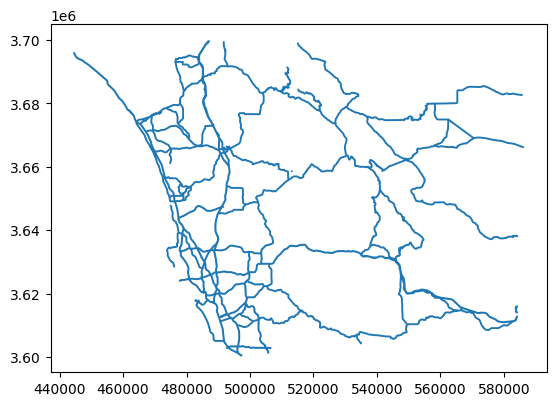

In [177]:
buffer.plot()

<Axes: >

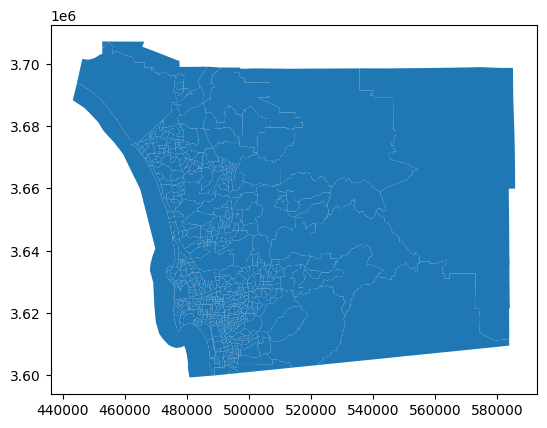

In [178]:
sd.plot()

In [179]:
buffer['buffer'] = 1

In [180]:
faces = sd.overlay(buffer, how='union')
faces.reset_index(inplace=True)

/opt/tljh/user/lib/python3.9/site-packages/geopandas/geodataframe.py:2451: UserWarning: `keep_geom_type=True` in overlay resulted in 150 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  return geopandas.overlay(


In [181]:
faces.shape

(1121, 161)

In [182]:
faces['buffer']

0       1.0
1       1.0
2       1.0
3       1.0
4       1.0
       ... 
1116    NaN
1117    NaN
1118    NaN
1119    NaN
1120    1.0
Name: buffer, Length: 1121, dtype: float64

In [183]:
faces['buffer'] = faces['buffer'].fillna(0)

In [184]:
faces['buffer']

0       1.0
1       1.0
2       1.0
3       1.0
4       1.0
       ... 
1116    0.0
1117    0.0
1118    0.0
1119    0.0
1120    1.0
Name: buffer, Length: 1121, dtype: float64

In [185]:
sd.shape

(628, 159)

<Axes: >

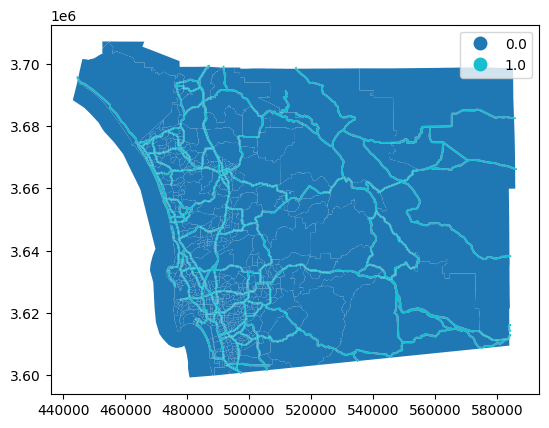

In [186]:
faces.plot(column='buffer', categorical=True, legend=True)

In [193]:
faces.groupby(by='buffer').count()

,index,geoid,n_mexican_pop,n_cuban_pop,n_puerto_rican_pop,n_russian_pop,n_italian_pop,n_german_pop,n_irish_pop,n_scandaniavian_pop,...,p_poverty_rate_over_65,p_poverty_rate_children,p_poverty_rate_white,p_poverty_rate_black,p_poverty_rate_hispanic,p_poverty_rate_native,p_poverty_rate_asian,year,_dvar,geometry
buffer,,,,,,,,,,,,,,,,,,,,,
0.0,628,628,628,628,628,628,628,628,628,628,...,628,628,628,628,628,628,628,628,628,628
1.0,493,492,492,492,492,492,492,492,492,492,...,492,492,492,492,492,492,492,492,492,493


In [194]:
faces.head()

,index,geoid,n_mexican_pop,n_cuban_pop,n_puerto_rican_pop,n_russian_pop,n_italian_pop,n_german_pop,n_irish_pop,n_scandaniavian_pop,...,p_poverty_rate_children,p_poverty_rate_white,p_poverty_rate_black,p_poverty_rate_hispanic,p_poverty_rate_native,p_poverty_rate_asian,year,_dvar,buffer,geometry
0,0,06073000100,278.0,19.0,9.0,42.0,125.0,86.0,65.0,11.0,...,0.000000,1.616554,0.00000,1.260912,0.000000,0.0,2019.0,1.0,1.0,"MULTIPOLYGON (((482146.587 3624430.270, 482144..."
1,1,06073000201,95.0,11.0,0.0,23.0,44.0,32.0,64.0,0.0,...,0.581703,10.470650,0.00000,1.322052,0.581703,0.0,2019.0,1.0,1.0,"POLYGON ((483329.845 3624434.530, 483414.898 3..."
2,2,06073000202,372.0,36.0,36.0,63.0,148.0,160.0,37.0,0.0,...,0.468645,3.347467,0.00000,0.848025,0.000000,0.0,2019.0,1.0,1.0,"POLYGON ((482778.615 3623152.865, 482785.384 3..."
3,3,06073000300,757.0,0.0,43.0,7.0,87.0,209.0,192.0,0.0,...,0.217477,11.111111,0.90945,2.412021,0.000000,0.0,2019.0,1.0,1.0,"POLYGON ((485076.654 3623400.232, 485141.579 3..."
4,4,06073000400,701.0,0.0,11.0,29.0,66.0,61.0,16.0,0.0,...,0.000000,4.068462,1.37486,1.206510,0.000000,0.0,2019.0,1.0,1.0,"POLYGON ((484058.709 3624558.267, 484249.019 3..."


Now we have faces classified as within and outside of the buffer.

In [195]:
faces[['median_household_income', 'buffer']].groupby(by='buffer').mean()

,median_household_income
buffer,
0.0,82819.480892
1.0,82525.831301


In [196]:
faces.explore(column='median_household_income', legend=True, tooltip=['buffer', 'median_household_income'])

Note that this makes sense only for the intensive variables since the estimate is a spatial join. That is the face is assigned the source value of the polygon it is within.
In other words, each face is a proper subset of a single source polygon.

It does not make sense for extensive values, since there would be double counting in cases where a source polygon generates multiple faces.



In [197]:
medians = faces[['median_household_income', 'buffer']].groupby(by='buffer').mean()

In [198]:
df = faces[['median_household_income', 'buffer']]

In [199]:
import seaborn as sns

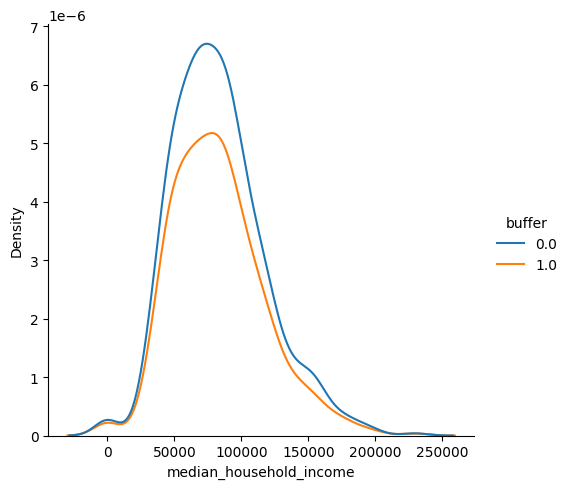

In [200]:
sns.displot(data=df, x='median_household_income', hue='buffer', kind='kde')

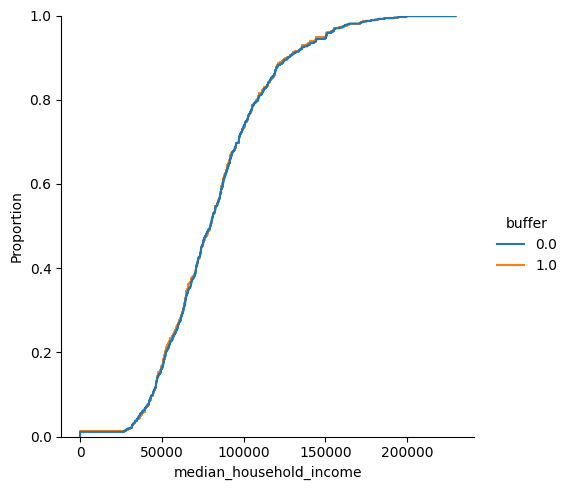

In [201]:
sns.displot(data=df, x='median_household_income', hue='buffer', kind='ecdf')

<Axes: xlabel='buffer', ylabel='median_household_income'>

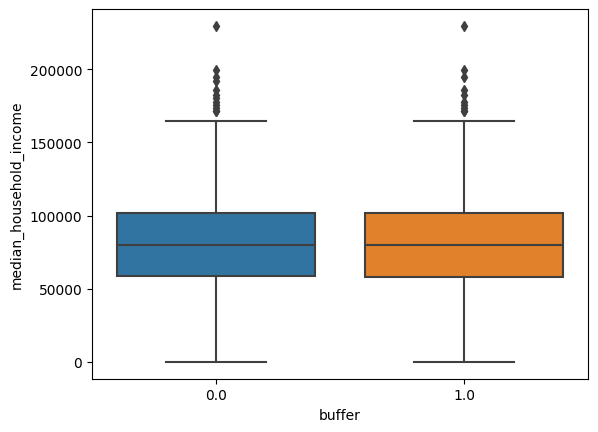

In [202]:
sns.boxplot(data=df, y='median_household_income', x='buffer')

In [203]:
from scipy import stats
import numpy as np
rng = np.random.default_rng()

In [204]:
df.fillna(0, inplace=True)

/tmp/ipykernel_3461790/4231983114.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.fillna(0, inplace=True)


In [205]:

buffer = df[df.buffer==1].median_household_income.values
outside = df[df.buffer==0].median_household_income.values

In [206]:
stats.ttest_ind(buffer, outside)

TtestResult(statistic=-0.22331020755340844, pvalue=0.8233348414818957, df=1119.0)

In [207]:
buffer.mean(), outside.mean()

(82358.43610547668, 82819.48089171975)

In [208]:
f'The difference of {buffer.mean() - outside.mean()} is not signficantly different from 0'

'The difference of -461.04478624307376 is not signficantly different from 0'

This assumes independence. Which is likely violated in our case.

In [209]:
buffer_rid = df.buffer

In [210]:
buffer_rid

0       1.0
1       1.0
2       1.0
3       1.0
4       1.0
       ... 
1116    0.0
1117    0.0
1118    0.0
1119    0.0
1120    1.0
Name: buffer, Length: 1121, dtype: float64

In [211]:
permutations = 99

In [212]:
np.random.seed(12345)

In [213]:
buffer_rid = np.random.permutation(buffer_rid)

In [214]:
observed_diff = buffer.mean() - outside.mean()

In [215]:
buffer_rid

array([0., 1., 1., ..., 1., 1., 1.])

In [216]:
diffs = np.zeros((permutations+1,1))
neg = 0
for permutation in range(permutations):
    buffer_rid = np.random.permutation(buffer_rid)
    df['buffer_rid'] = buffer_rid
    buffer = df[df.buffer_rid==1].median_household_income.values
    outside = df[df.buffer_rid==0].median_household_income.values
    diff = buffer.mean() - outside.mean()
    if neg < 0:
        neg += 1
    diffs[permutation] = diff

/tmp/ipykernel_3461790/132488425.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['buffer_rid'] = buffer_rid


In [217]:
diffs[-1] = observed_diff

In [218]:
observed_diff

-461.04478624307376

In [219]:
(diffs <= observed_diff).sum()

37

In [220]:
diff

-468.27905324220774

In [221]:
outside.shape

(628,)

In [222]:
diffs.mean()

209.07170220668894

In [223]:
p_value = (diffs <= observed_diff).sum() / (1 + permutations)
p_value

0.37

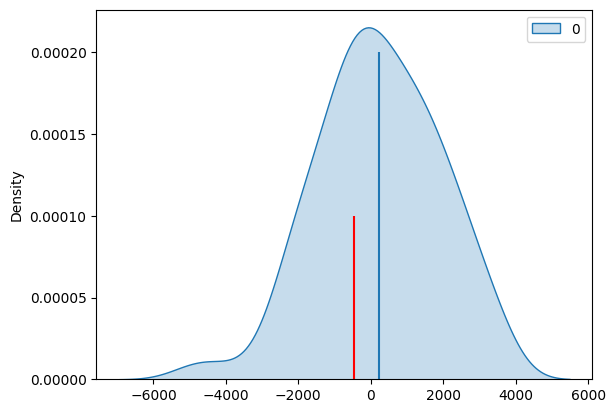

In [224]:
sns.kdeplot(diffs, fill=True)
plt.vlines(diffs[:-1].mean(), 0, 0.0002)
plt.vlines(observed_diff, 0, 0.0001, 'r')

In [ ]:
groups = [f'median_income_{group}hh' for group in ['hispanic', 'white', 'black']]

In [ ]:
groups

In [ ]:
for group in groups:
    nzt = sd[sd[group]>0][group].mean()
    print(group, nzt)